##### Necessary Libraries

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

##### Data Loading

In [3]:
df=pd.read_csv(r'C:\Users\venom\Downloads\cardioActivities.csv')
display(df.head())
print('\n',df.info())
print('\n',df.describe())
print('\n',df.shape)

,Date,Activity Id,Type,Route Name,Distance (km),Duration,Average Pace,Average Speed (km/h),Calories Burned,Climb (m),Average Heart Rate (bpm),Friend's Tagged,Notes,GPX File
0,2018-11-11 14:05:12,c9627fed-14ac-47a2-bed3-2a2630c63c15,Running,NaN,10.44,58:40,5:37,10.68,774.0,130,159.0,NaN,NaN,2018-11-11-140512.gpx
1,2018-11-09 15:02:35,be65818d-a801-4847-a43b-2acdf4dc70e7,Running,NaN,12.84,1:14:12,5:47,10.39,954.0,168,159.0,NaN,NaN,2018-11-09-150235.gpx
2,2018-11-04 16:05:00,c09b2f92-f855-497c-b624-c196b3ef036c,Running,NaN,13.01,1:15:16,5:47,10.37,967.0,171,155.0,NaN,NaN,2018-11-04-160500.gpx
3,2018-11-01 14:03:58,bc9b612d-3499-43ff-b82a-9b17b71b8a36,Running,NaN,12.98,1:14:25,5:44,10.47,960.0,169,158.0,NaN,NaN,2018-11-01-140358.gpx
4,2018-10-27 17:01:36,972567b2-1b0e-437c-9e82-fef8078d6438,Running,NaN,13.02,1:12:50,5:36,10.73,967.0,170,154.0,NaN,NaN,2018-10-27-170136.gpx


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 508 entries, 0 to 507
Data columns (total 14 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Date                      508 non-null    object 
 1   Activity Id               508 non-null    object 
 2   Type                      508 non-null    object 
 3   Route Name                1 non-null      object 
 4   Distance (km)             508 non-null    float64
 5   Duration                  508 non-null    object 
 6   Average Pace              508 non-null    object 
 7   Average Speed (km/h)      508 non-null    float64
 8   Calories Burned           508 non-null    float64
 9   Climb (m)                 508 non-null    int64  
 10  Average Heart Rate (bpm)  294 non-null    float64
 11  Friend's Tagged           0 non-null      float64
 12  Notes                     231 non-null    object 
 13  GPX File                  504 non-null    object 
dtypes: float64

##### Data Cleaning and Preprocessing

In [4]:
cols=['Friend\'s Tagged','Route Name','GPX File','Activity Id','Calories Burned','Notes']
df.drop(cols,axis=1,inplace=True)
df['Type']=df['Type'].str.replace("Other","Unicycling")
display(df.isnull().sum()) # checking null values

Date                          0
Type                          0
Distance (km)                 0
Duration                      0
Average Pace                  0
Average Speed (km/h)          0
Climb (m)                     0
Average Heart Rate (bpm)    214
dtype: int64

In [5]:
avg_run=df[df['Type']=='Running']['Average Heart Rate (bpm)'].mean()
avg_cycle=df[df['Type']=='Cycling']['Average Heart Rate (bpm)'].mean()

df_run=df[df['Type']=='Running'].copy()
df_walk = df[df['Type']=='Walking'].copy()
df_cycle=df[df['Type']=='Cycling'].copy()

df_walk['Average Heart Rate (bpm)'].fillna(110,inplace=True)
df_run['Average Heart Rate (bpm)'].fillna(int(avg_run),inplace=True)
df_cycle['Average Heart Rate (bpm)'].fillna(int(avg_cycle),inplace=True)

# Count missing values for each column in running data
df_run.isnull().sum()

C:\Users\venom\AppData\Local\Temp\ipykernel_6832\493263053.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_walk['Average Heart Rate (bpm)'].fillna(110,inplace=True)
C:\Users\venom\AppData\Local\Temp\ipykernel_6832\493263053.py:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.


Date                        0
Type                        0
Distance (km)               0
Duration                    0
Average Pace                0
Average Speed (km/h)        0
Climb (m)                   0
Average Heart Rate (bpm)    0
dtype: int64

In [6]:
# Combine all cleaned activity DataFrames into one
df1=pd.concat([df_run,df_walk,df_cycle])
df1.sort_index(inplace=True)

print(df1.shape)
display(df1.head())

(506, 8)


,Date,Type,Distance (km),Duration,Average Pace,Average Speed (km/h),Climb (m),Average Heart Rate (bpm)
0,2018-11-11 14:05:12,Running,10.44,58:40,5:37,10.68,130,159.0
1,2018-11-09 15:02:35,Running,12.84,1:14:12,5:47,10.39,168,159.0
2,2018-11-04 16:05:00,Running,13.01,1:15:16,5:47,10.37,171,155.0
3,2018-11-01 14:03:58,Running,12.98,1:14:25,5:44,10.47,169,158.0
4,2018-10-27 17:01:36,Running,13.02,1:12:50,5:36,10.73,170,154.0


In [7]:
def classify(row): # classify terrains
  if row['Climb (m)']<=50:
    return 'Flat'
  elif row['Climb (m)']>50 and row['Climb (m)']<=100:
    return 'Mixed'
  else:
    return 'Hilly'
df1['Terrain']=df1.apply(classify,axis=1)

df1['Average Pace']=df1['Average Pace'].apply(lambda x:int(x.split(':')[0])+int(x.split(':')[1])/60)
df1['Average Pace']=df1['Average Pace'].round(2)

def convert(time):
    p=list(map(int,time.split(':')))
    if len(p)==2:
        m,s=p
        return m*60+s
    elif len(p)==3:
        h,m,s=p
        return h*3600+m*60+s
    else:
        return None
df1['Duration']=df1['Duration'].apply(convert)

In [8]:
def iqr(data,column): # remove outliers
    Q1=data[column].quantile(0.25)
    Q3=data[column].quantile(0.75)
    IQR=Q3-Q1
    lower_bound=Q1-1.5*IQR
    upper_bound=Q3+1.5*IQR
    return data[(data[column]>=lower_bound) & (data[column]<=upper_bound)]
columns=['Distance (km)','Average Heart Rate (bpm)','Average Pace','Climb (m)','Duration']
for col in columns:
    df1=iqr(df1,col)

In [9]:
display(df1)
print(df1.info()) # confirming conversion to datetime
print('\n',df1.shape) # after cleaning

,Date,Type,Distance (km),Duration,Average Pace,Average Speed (km/h),Climb (m),Average Heart Rate (bpm),Terrain
17,2018-08-08 18:44:59,Running,15.27,4777,5.22,11.51,241,150.0,Hilly
18,2018-08-05 10:17:10,Running,18.70,6559,5.85,10.26,280,150.0,Hilly
19,2018-08-01 18:20:26,Running,18.20,6185,5.67,10.59,259,145.0,Hilly
21,2018-07-30 18:18:47,Running,17.87,6240,5.82,10.31,261,141.0,Hilly
22,2018-07-27 11:43:03,Running,12.71,4491,5.88,10.19,180,145.0,Hilly
...,...,...,...,...,...,...,...,...,...
494,2012-09-08 08:35:02,Running,3.27,955,4.87,12.32,15,144.0,Flat
495,2012-09-04 19:12:17,Running,6.26,1955,5.20,11.53,34,144.0,Flat
498,2012-09-02 08:41:31,Running,3.14,976,5.18,11.56,18,144.0,Flat
506,2012-08-24 08:13:12,Running,3.15,960,5.08,11.82,17,144.0,Flat


<class 'pandas.core.frame.DataFrame'>
Index: 367 entries, 17 to 507
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Date                      367 non-null    object 
 1   Type                      367 non-null    object 
 2   Distance (km)             367 non-null    float64
 3   Duration                  367 non-null    int64  
 4   Average Pace              367 non-null    float64
 5   Average Speed (km/h)      367 non-null    float64
 6   Climb (m)                 367 non-null    int64  
 7   Average Heart Rate (bpm)  367 non-null    float64
 8   Terrain                   367 non-null    object 
dtypes: float64(4), int64(2), object(3)
memory usage: 28.7+ KB
None

 (367, 9)


##### Effectiveness of Data Visualization in Running Performance Analysis

Exploratory Data Analysis

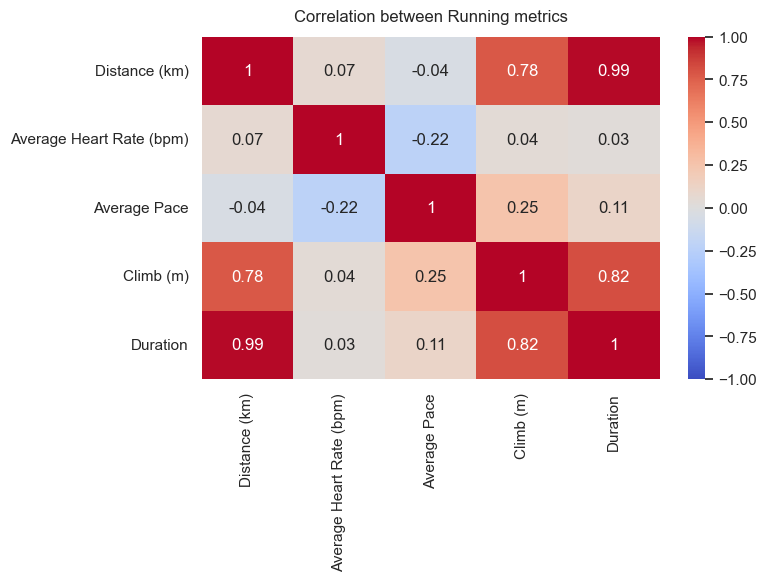

In [23]:
# correlation between different metrics
corr_df=df1[['Distance (km)','Average Heart Rate (bpm)','Average Pace','Climb (m)','Duration']] # correlation matrix
correlation_matrix=corr_df.corr().round(2)
plt.figure(figsize=(8,6))
sns.heatmap(correlation_matrix,annot=True,cmap='coolwarm',vmin=-1,vmax=1)
plt.title("Correlation between Running metrics",y=1.02)
plt.tight_layout()
plt.show()

In [11]:
fig=px.parallel_coordinates(df1,color="Average Heart Rate (bpm)",dimensions=["Distance (km)","Duration","Average Pace","Average Speed (km/h)","Climb (m)","Average Heart Rate (bpm)"],
    color_continuous_scale=px.colors.diverging.Tealrose,color_continuous_midpoint=df1["Average Heart Rate (bpm)"].mean())
fig.update_layout(title=dict(text="Parallel Coordinates Chart of Running Sessions",y=1,x=0.5))
fig.show()

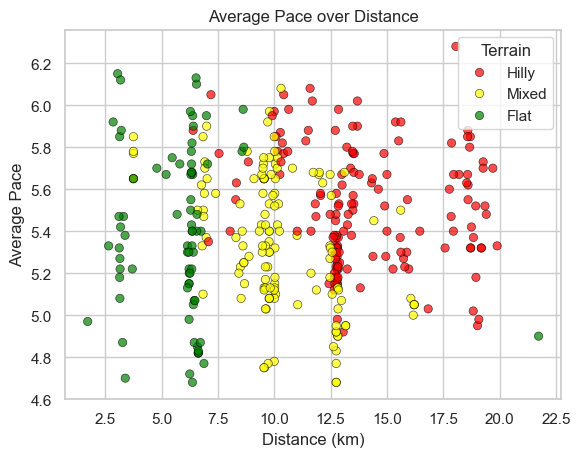

In [24]:
# distribution of average pace according to Terrain
sns.scatterplot(data=df1,x='Distance (km)',y='Average Pace',hue='Terrain',alpha=0.7,palette={'Hilly':'red','Flat':'green','Mixed':'yellow'},edgecolor='black')
plt.title('Average Pace over Distance')
plt.show()

Brief Text Summary of Running Performance

In [13]:
text_summary = df1.groupby('Terrain')[['Average Pace', 'Average Heart Rate (bpm)', 'Distance (km)', 'Duration']].mean().round(2)
print("Text-based Summary:\n", text_summary)

Text-based Summary:
          Average Pace  Average Heart Rate (bpm)  Distance (km)  Duration
Terrain                                                                 
Flat             5.40                    143.94           5.79   1871.09
Hilly            5.51                    144.41          13.99   4616.03
Mixed            5.36                    143.99          10.15   3239.06


Visual representation of Running Performance Compare to Traditional textbased Reports

In [14]:
# average pace of some previous activity
df_flat=df1[df1['Terrain']=='Flat'].sort_values('Date')
df_flat_last10=df_flat.tail(10)
fig=px.bar(df_flat_last10,x='Date',y='Average Pace',title='Average Pace on Flat Terrain',text='Average Pace',color_discrete_sequence=['green'])
fig.update_layout(bargap=0.05,xaxis_title='Date',yaxis_title='Average Pace',xaxis={'type':'category'})
fig.show()

In [15]:
df_hilly=df1[df1['Terrain']=='Hilly'].sort_values('Date')
df_hilly_last10=df_hilly.tail(10)
fig=px.bar(df_hilly_last10,x='Date',y='Average Pace',title='Average Pace on Hilly Terrain',text='Average Pace',color_discrete_sequence=['green'])
fig.update_layout(bargap=0.05,xaxis_title='Date',yaxis_title='Average Pace',xaxis={'type':'category'})
fig.show()

In [16]:
df_mixed=df1[df1['Terrain']=='Mixed'].sort_values('Date')
df_mixed_last10=df_mixed.tail(10)
fig=px.bar(df_mixed_last10,x='Date',y='Average Pace',title='Average Pace on Mixed Terrain',text='Average Pace',color_discrete_sequence=['green'])
fig.update_layout(bargap=0.05,xaxis_title='Date',yaxis_title='Average Pace',xaxis={'type':'category'})
fig.show()

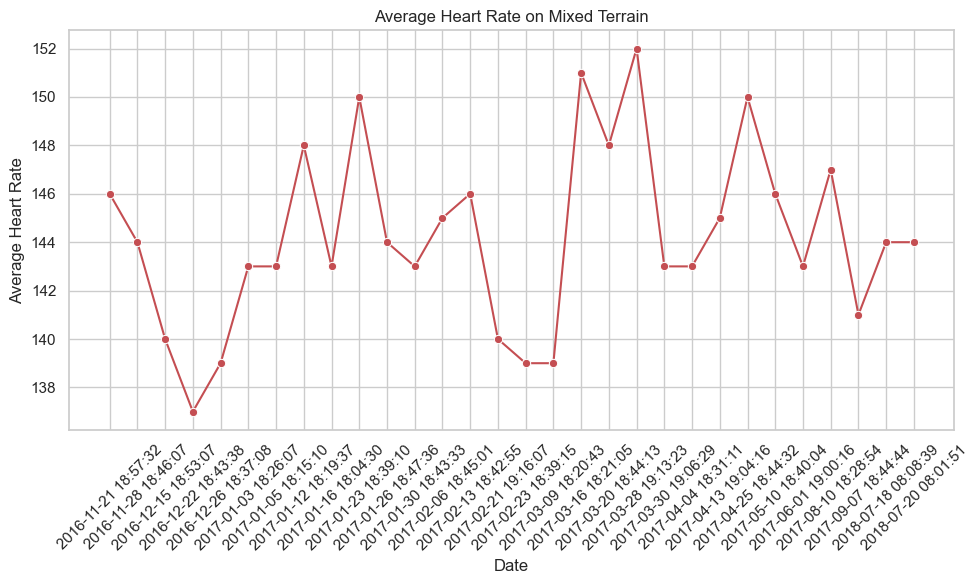

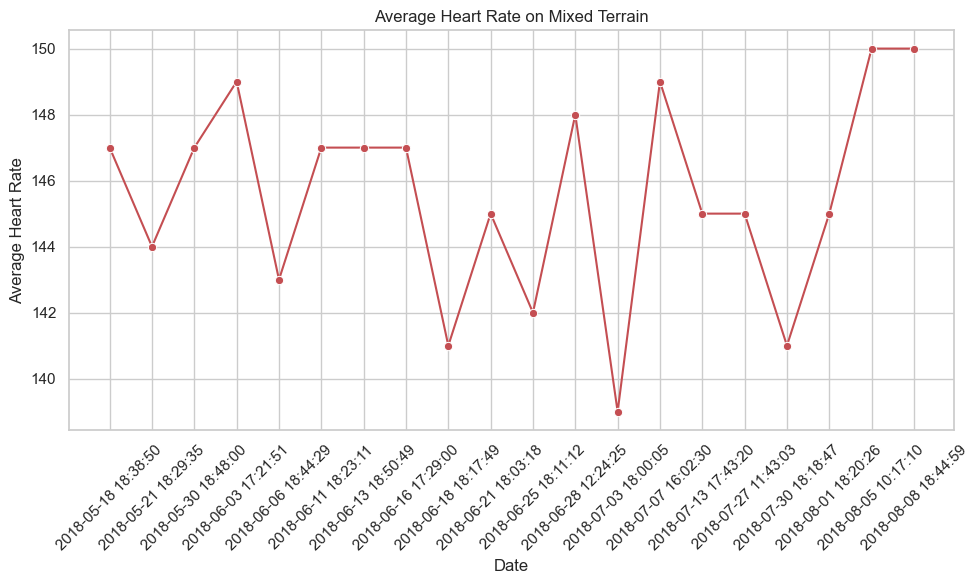

In [25]:
# average heart rate trend during activity
df_m=df1[df1['Terrain']=='Mixed'].sort_values('Date')
df_=df_m.tail(30)
plt.figure(figsize=(10,6))
sns.set_style("whitegrid")
sns.lineplot(data=df_,x='Date',y='Average Heart Rate (bpm)',marker='o',color='r')
plt.title('Average Heart Rate on Mixed Terrain')
plt.xlabel('Date')
plt.ylabel('Average Heart Rate')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

df_f=df1[df1['Terrain']=='Hilly'].sort_values('Date')
df_=df_f.tail(20)
plt.figure(figsize=(10,6))
sns.set_style("whitegrid")
sns.lineplot(data=df_,x='Date',y='Average Heart Rate (bpm)',marker='o',color='r')
plt.title('Average Heart Rate on Mixed Terrain')
plt.xlabel('Date')
plt.ylabel('Average Heart Rate')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Can Clustering Techniques accurately classify running Terrains based on Elevation ?

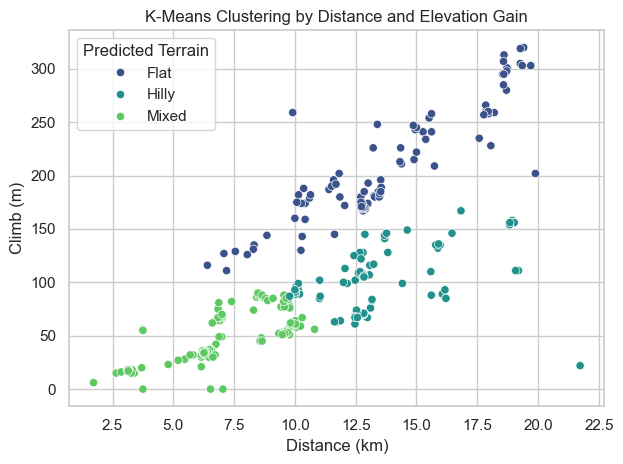

In [20]:
df_cluster=df1[['Terrain','Climb (m)','Distance (km)']].dropna().copy()
df_cluster['Gradient']=df_cluster['Climb (m)']/df_cluster['Distance (km)']
features=df_cluster[['Climb (m)','Distance (km)','Gradient']]
scaler=StandardScaler()
scaled_features=scaler.fit_transform(features)
kmeans=KMeans(n_clusters=3)
df_cluster['Cluster_KMeans']=kmeans.fit_predict(scaled_features)
cluster_to_terrain={0:'Mixed',1:'Flat',2:'Hilly'}
df_cluster['Pred_Terrain_KMeans']=df_cluster['Cluster_KMeans'].map(cluster_to_terrain)
df1['Pred_Terrain_KMeans']=df_cluster['Pred_Terrain_KMeans']

sns.set(style="whitegrid")
sns.scatterplot(data=df_cluster,x='Distance (km)',y='Climb (m)',hue='Pred_Terrain_KMeans',palette='viridis')
plt.title('K-Means Clustering by Distance and Elevation Gain')
plt.xlabel('Distance (km)')
plt.ylabel('Climb (m)')
plt.legend(title='Predicted Terrain')
plt.tight_layout()
plt.show()

How Terrain type affect Fatigue patterns as indicated by Pace drop-off and Heart Rate fluctuations ?


Future Predictions for Flat Terrain:
Time: 113.63 minutes, Predicted Heart Rate: 144.19 bpm
Time: 114.63 minutes, Predicted Heart Rate: 144.19 bpm
Time: 115.63 minutes, Predicted Heart Rate: 144.19 bpm

Future Predictions for Hilly Terrain:
Time: 106.63 minutes, Predicted Heart Rate: 143.70 bpm
Time: 107.63 minutes, Predicted Heart Rate: 143.68 bpm
Time: 108.63 minutes, Predicted Heart Rate: 143.66 bpm

Future Predictions for Mixed Terrain:
Time: 62.60 minutes, Predicted Heart Rate: 143.89 bpm
Time: 63.60 minutes, Predicted Heart Rate: 143.88 bpm
Time: 64.60 minutes, Predicted Heart Rate: 143.88 bpm


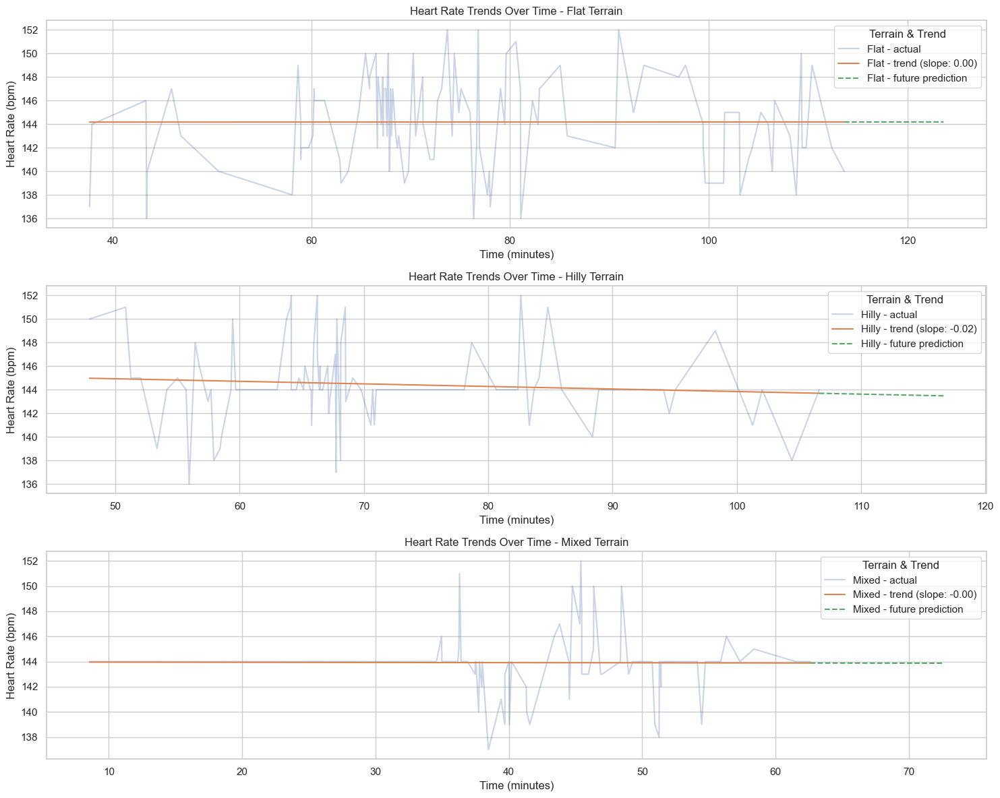

In [22]:
df_hr=df1.dropna(subset=['Average Heart Rate (bpm)','Duration'])
df_hr['Time_Min']=df_hr['Duration']/60
terrains=df_hr['Pred_Terrain_KMeans'].unique()
plt.figure(figsize=(15, 12))
sns.set(style="whitegrid")
for i,terrain in enumerate(terrains,1):
    plt.subplot(3,1,i)
    subset=df_hr[df_hr['Pred_Terrain_KMeans']==terrain].copy()
    subset=subset.sort_values(by='Time_Min')
    X=subset['Time_Min'].values.reshape(-1,1)
    y=subset['Average Heart Rate (bpm)'].values

    model=LinearRegression()
    model.fit(X,y)
    y_pred=model.predict(X)
    slope=model.coef_[0]

    plt.plot(subset['Time_Min'],subset['Average Heart Rate (bpm)'],alpha=0.3,label=f'{terrain} - actual') # Plot actual data and regression trend line
    plt.plot(subset['Time_Min'],y_pred,label=f'{terrain} - trend (slope: {slope:.2f})')

    future_time=np.arange(subset['Time_Min'].max(),subset['Time_Min'].max()+11,1).reshape(-1,1)
    future_preds=model.predict(future_time)
    plt.plot(future_time,future_preds,'--',label=f'{terrain} - future prediction')
    print(f"\nFuture Predictions for {terrain.capitalize()} Terrain:")
    for t,pred in zip(future_time.flatten()[:3],future_preds[:3]):
        print(f"Time: {t:.2f} minutes, Predicted Heart Rate: {pred:.2f} bpm")

    plt.title(f'Heart Rate Trends Over Time - {terrain.capitalize()} Terrain')
    plt.xlabel('Time (minutes)')
    plt.ylabel('Heart Rate (bpm)')
    plt.legend(title='Terrain & Trend')
    plt.tight_layout()
plt.show()